# $n$-island model with single step population size change

Let us recall the expressions of the c.d.f. and the d.f. of coalescence time in the $n$-island model.

For positive parameters $n \in \mathbb{N}$ (number of islands) and $M$ (migration rate) and $\rho$ the relative population size, the $Q$-matrix generating the process is
$$
    {Q} = \left(
        \begin{array}{ccc}
            -(M + 1/\rho ) & M & 1/\rho \\
            \frac{M}{n-1} & - \frac{M}{n-1} & 0 \\
            0 & 0 & 0
        \end{array}
    \right).
$$
To find the analytical expressions for the densities of $T_2^s$ and $T_2^d$, we will use the equations (10)-(20) in Mazet et al. (2016) and the re-scaling discussed in the appendices of the main document.
Let us define 
$$
    \gamma = \frac{M}{n-1} \rho
$$ 
and
\begin{align*}
    \alpha &= \frac{1}{2 \rho} (1 + n \gamma + \sqrt{\Delta})\\
    \beta &= \frac{1}{2 \rho} (1 + n \gamma - \sqrt{\Delta})
\end{align*}
where $\Delta = (1 + n \gamma)^2 - 4 \gamma$, and $\Delta / 4 \rho^2$ is the discriminant of the characteristic polynomial of $Q$: 
$$
    D: \theta \mapsto \theta^2 + \theta \frac{1 + n \gamma}{\rho} + \frac{\gamma}{\rho^2}. 
$$    
Note that $-\alpha$ and $-\beta$ are the roots of the polynomial $D$.

The, the density functions of $T_2^s$ and $T_2^d$ are
\begin{align*}
    f_{T_2^s}(t) &= a \mathrm{e}^{- \alpha t} + (1-a) \mathrm{e}^{- \beta t} \\
    f_{T_2^d}(t) &= c \mathrm{e}^{- \alpha t} - c \mathrm{e}^{- \beta t}
\end{align*}
where $a = \frac{\gamma - \alpha}{\beta - \alpha}$ and $c = \frac{\gamma}{\beta - \alpha}$. Besides, $\alpha > \beta > 0$ and $\alpha \beta = \gamma/\rho^2$.

The IICR functions of $T_2^s$ and $T_2^d$ are
\begin{align*}
    \mathrm{IICR}_{T_2^s}(t) &= \rho \frac{( 1/\rho - \beta ) \mathrm{e}^{- {\alpha} t} + ( \alpha  - 1/\rho ) \mathrm{e}^{- {\beta} t}}{({\alpha} -{\gamma}/\rho) \mathrm{e}^{- {\alpha} t} + ({\gamma}/\rho - {\beta}) \mathrm{e}^{- {\beta} t}} = \rho \frac{( 1/\rho - \beta ) \mathrm{e}^{- t \sqrt{\Delta}/\rho} + \alpha  - 1/\rho }{({\alpha} -{\gamma}/\rho) \mathrm{e}^{- t \sqrt{\Delta}/\rho}  + {\gamma}/\rho - {\beta} } \\
    \mathrm{IICR}_{T_2^d}(t) &= \rho \frac{{\beta} \mathrm{e}^{- {\alpha} t} - {\alpha} \mathrm{e}^{- {\beta} t}}{ {\gamma}/\rho \, \mathrm{e}^{- {\alpha} t} - {\gamma}/\rho \, \mathrm{e}^{- {\beta} t}} = \rho \frac{{\beta} \mathrm{e}^{- t \sqrt{\Delta}/\rho} - {\alpha} }{ \gamma/\rho ( \mathrm{e}^{- t \sqrt{\Delta}/\rho } - 1) }.
\end{align*}

In [1]:
using Plots

In [2]:
# Defining the parameters
m = 0.5; # migration rate
n = 5.0; # number of islands
rho  = 1; # relative population size
Q = [-(m + 1/rho)  m 1/rho  ; m/(n-1) -m/(n-1) 0 ; 0 0 0]; # defining the Q-matrix
display(Q) # printing Q

3×3 Matrix{Float64}:
 -1.5     0.5    1.0
  0.125  -0.125  0.0
  0.0     0.0    0.0

In [8]:
function density_anal_nI(t,m, n, rho)
    # computing the densitiy of the n-island model 
    # using the analytical results in Mazet et al. (2016)
    γ = m/(n-1) * rho
    Δ = (1+n*γ)^2 - 4 * γ
    α = 1/2*(1 + n*γ + sqrt(Δ)) / rho
    β = 1/2*(1 + n*γ - sqrt(Δ)) / rho
    a = (γ/rho - α)/(β - α)
    c = γ/rho /(β - α)
    x = a*exp(- α * t) + (1 - a)*exp(- β * t)
    y = c*exp(- α * t) - c*exp(- β * t)
    return [x/rho,y/rho]
end

density_anal_nI (generic function with 1 method)

In [9]:
function IICR_anal_nI(t,m, n, rho)
    # computing the IICR of the n-island model 
    # using the analytical results in Mazet et al. (2016)
    γ = m/(n-1)*rho
    Δ = (1+n*γ)^2 - 4 * γ
    α = 1/2*(1 + n*γ + sqrt(Δ)) / rho
    β = 1/2*(1 + n*γ - sqrt(Δ)) / rho
    a = (γ / rho - α)/(β - α)
    c =  γ / rho /(β - α)
    x = ( (1/rho-β)*exp(-sqrt(Δ)/rho * t) + α - 1/rho )/( (α - γ/rho)*exp(- sqrt(Δ)/rho * t) + (γ/rho - β) )
    y = ( β*exp(- sqrt(Δ)/rho * t) - α )/( γ/rho*exp(- sqrt(Δ)/rho * t) - γ/rho )
    return [x*rho,y*rho]
end

IICR_anal_nI (generic function with 1 method)

In [10]:
# auxiliar function to compute the limit of the IICR function when t → ∞
# recall this is the maximum non-null eigenvalue of the rate matrix Q
function limit_IICR(m, n, rho)
    # computing the IICRs using the analytical results
    γ = m/(n-1)*rho
    Δ = (1+n*γ)^2 - 4 * γ
    β = 1/2*(1 + n*γ - sqrt(Δ)) / rho
    return β
end

limit_IICR (generic function with 1 method)

## Single step population size change

Let us consider the population size change function
$$
    \lambda(t) = \left\{
        \begin{array}{ccc}
            1 & \text { if } & t \le T,\\
            \alpha & \text { if } & t > T.
        \end{array}
    \right.
$$
Then, the panmictic population with size change $\lambda$ has coalescence time $T_2$ with density
$$
    f_{T_2} (t) = \left\{
        \begin{array}{ccc}
            \mathrm{e}^{-t} & \text{ if } & t < T\\
            \mathrm{e}^{-T} \frac{1}{\alpha} \mathrm{e}^{- \frac{1}{\alpha} (t- T)} & \text{ if } & t \ge T
        \end{array}
        \right.
$$

As explained in Mazet et al. (2015), for a fixed value of $\alpha$, we could set values of $m$ and $N$ in the $n$-island model such that the means and the variances (and also the densities) are close. We next consider the same examples as Figure 3 in Mazet et al. (2015).

### First example

In [11]:
# First example - Figure 3 left panel Mazet el at. (2015)
m_example1 = 9
n_example1 = 10
T_example1 = 0.1
α_example1 = 10.94
# 
function density_SSPSC(t,α,T)
    # Computing the density of the Single step population size change
    S = 0
    if t ≤ T 
        S = exp(-t)
    else
        S = 1/α * exp(-T - 1/α*(t - T))
    end
    return S
end

density_SSPSC (generic function with 1 method)

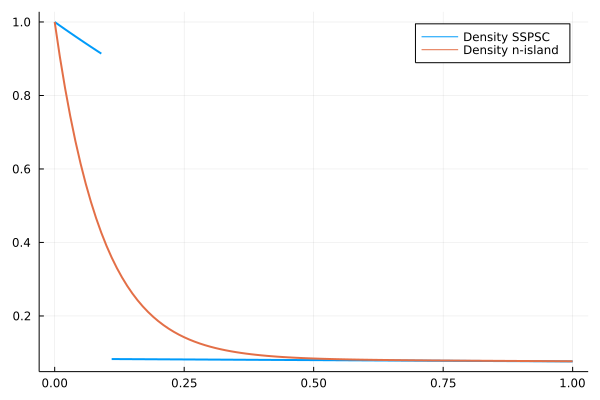

In [12]:
# Plotting the densities of the n-island and the panmictic population with SSPSC
xs = range(0, 1, step = 0.01);
# densities of T_2 for the n-island model when initially both individuals are in the same island
density_nisland_example1 = density_anal_nI.(xs,(m_example1,), (n_example1,), (1,));
density_nisland_example_ys_1 = [x[1] for x in density_nisland_example1];
# density of the SSPSC model
density_panmictic_example_ys_1 = density_SSPSC.(xs,(α_example1,),(T_example1,));
#
# Making the discontinuous value = NaN
# this makes that the plot of the function jumps without the vertical lines
for x = 2:length(xs)
    if abs(xs[x] - T_example1) < 0.005
        density_panmictic_example_ys_1[x] = NaN
    end
end
# 
fig_density_SSPSC_nisland = plot(xs, density_panmictic_example_ys_1, label="Density SSPSC", w = 2)
fig_density_SSPSC_nisland = plot!(xs, density_nisland_example_ys_1, label="Density n-island", w = 2)
display(fig_density_SSPSC_nisland)
# savefig(fig_density_SSPSC_nisland,"fig_density_SSPSC_nisland.pdf")

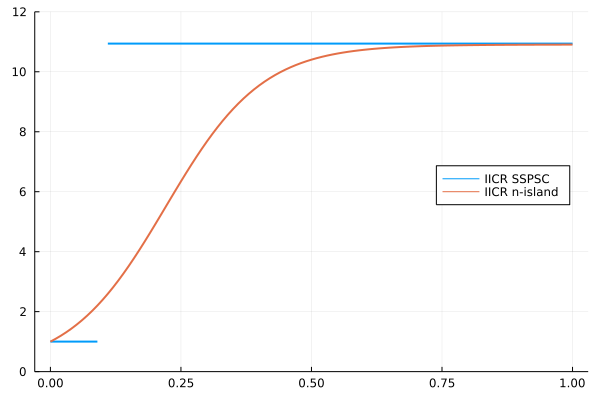

In [13]:
# First example - Figure 3 left panel Mazet el at. (2015)
m_example1 = 9
n_example1 = 10
T_example1 = 0.1
α_example1 = 10.94
# 
function IICR_SSPSC(t,α,T)
    # Computing the IICR function of the Single step population size change
    # In this case it is exactly the population size of the panmictic population
    S = 1
    if t > T 
        S = α
    end
    return S
end
# 
xs = range(0, 1, step = 0.01);
# IICR of T_2 for the n-island model when initially both individuals are in the same island
IICR_nisland_example1 = IICR_anal_nI.(xs,(m_example1,), (n_example1,), (1,));
IICR_nisland_example_ys_1 = [x[1] for x in IICR_nisland_example1];
# IICR of the SSPSC model
IICR_panmictic_example_ys_1 = IICR_SSPSC.(xs,(α_example1,),(T_example1,));
# Making the discontinuous values = NaN
for x = 2:length(xs)
    if abs(xs[x] - T_example1) < 0.005
        IICR_panmictic_example_ys_1[x] = NaN
    end
end
#
fig_IICR_SSPSC_nisland = plot(xs, IICR_panmictic_example_ys_1, label="IICR SSPSC", w = 2, legend=:right)
fig_IICR_SSPSC_nisland = plot!(xs, IICR_nisland_example_ys_1, label="IICR n-island", w = 2)
ylims!((0,12))
display(fig_IICR_SSPSC_nisland)
# savefig(fig_IICR_SSPSC_nisland,"fig_IICR_SSPSC_nisland.pdf")

### Strong migration

In [14]:
# First example - Figure 3 left panel Mazet el at. (2015)
m_example1 = 9
n_example1 = 10
T_example1 = 0.1
α_example1 = 10.94
# 
# auxiliar parameters
β_example1 = limit_IICR(m_example1, n_example1, 1)
display(α_example1/β_example1) # limit of the IICR_SM
# 
function IICR_nisland_with_SSPSC(t,α,T, m, n)
    # Computing the IICR of the n-island model with a single step population size change
    S = 1
    if t ≤ T 
        S = IICR_anal_nI(t,m, n, 1)
    else
        S = α* IICR_anal_nI(T + 1/α*(t-T),m, n, 1)
    end
    return S
end

119.3370964303646

IICR_nisland_with_SSPSC (generic function with 1 method)

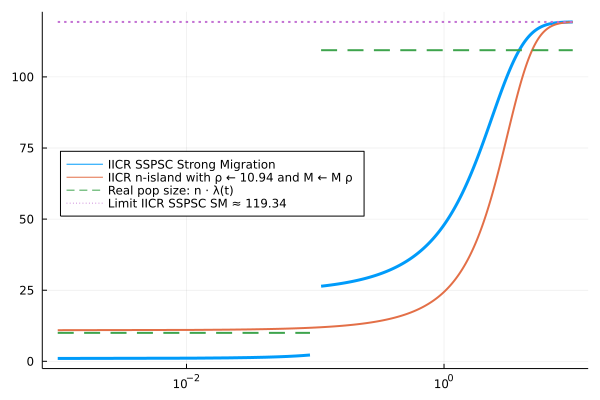

In [21]:
# Plotting the strong migration case 
xs = range(0.001, 10, step = 0.01);
#
IICR_nisland_example2 = IICR_anal_nI.(xs,(m_example1/α_example1,), (n_example1,), (α_example1,)); 
# IICR of the n-island with α_example1 and migration also divided by α_example1
IICR_nisland_example_ys_2 = [x[1] for x in IICR_nisland_example2]; # extract first component
#
#
IICR_panmictic_example_ys_1 = IICR_SSPSC.(xs,(α_example1,),(T_example1,)); # IICR of the SSPSC model
#
# IICR of the n-island with SSPSC and strong migration
IICR_nisland_with_SSPSC_1 = IICR_nisland_with_SSPSC.(xs,(α_example1,),(T_example1,),(m_example1,),(n_example1,));
IICR_nisland_with_SSPSC_ys_1 = [x[1] for x in IICR_nisland_with_SSPSC_1]
# Making the discontinuous values = NaN
for x = 2:length(xs)
    if abs(xs[x] - T_example1) < 0.005
        IICR_nisland_with_SSPSC_ys_1[x] = NaN
        IICR_panmictic_example_ys_1[x] = NaN
    end
end
#
# Plots
# we use x log axis to increase readability
fig_IICR_SSPSC_nisland_SM = plot(xs, IICR_nisland_with_SSPSC_ys_1, label="IICR SSPSC Strong Migration", w = 3, legend = :left, xaxis = :log)
# 
fig_IICR_SSPSC_nisland_SM = plot!(xs, IICR_nisland_example_ys_2, label="IICR n-island with ρ ← 10.94 and M ← M ρ", w = 2)
#
fig_IICR_SSPSC_nisland_SM = plot!(xs, n_example1*IICR_panmictic_example_ys_1, label="Real pop size: n ⋅ λ(t)", w = 2, line = :dash)
fig_IICR_SSPSC_nisland_SM = plot!([first(xs), last(xs)], [α_example1/ β_example1 , α_example1/ β_example1], 
    label="Limit IICR SSPSC SM ≈ 119.34", w = 2, line =  :dot)
# 
display(fig_IICR_SSPSC_nisland_SM)
# savefig(fig_IICR_SSPSC_nisland_SM,"fig_IICR_SSPSC_nisland_SM.pdf")

### Weak migration

In [22]:
# First example - Figure 3 left panel Mazet el at. (2015)
m_example1 = 9.0
n_example1 = 10.0
T_example1 = 0.1
α_example1 = 10.94
# 
# auxiliar parameters
β_example1 = limit_IICR(m_example1, n_example1, α_example1)
display(1/β_example1) # limit of the IICR_SM
# 
# cumputing the IICR of the n-island model with SSPSC and weak migration
function IICR_nisland_with_SSPSC_WM(t,α,T, m, n)
    Q1 = [-(m + 1)  m 1 ; 
            m/(n-1) -m/(n-1) 0 ; 
            0 0 0]
    Q2 = [-(m + 1/α)  m 1/α ; 
            m/(n-1) -m/(n-1) 0 ; 
            0 0 0]
    S = 1
    A = 1
    B = 1
    if t ≤ T
        A = exp(t*Q1)
        B = A*Q1
        A = A[1,3]
        B = B[1,3]
        S = (1-A)/B
    else
        A = exp(T*Q1)*exp((t-T)*Q2)
        B = A*Q2
        A = A[1,3]
        B = B[1,3]
        S = (1-A)/B
    end
    return S
end

110.3008166908621

IICR_nisland_with_SSPSC_WM (generic function with 1 method)

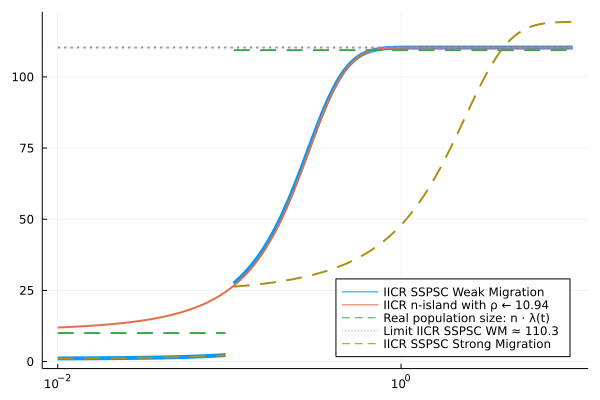

In [31]:
# plotting for the weak migration case
xs = range(0.01, 10, step = 0.001);
# IICR of the n-island model with λ = α
IICR_nisland_example2 = IICR_anal_nI.(xs,(m_example1,), (n_example1,), (α_example1,));
IICR_nisland_example_ys_2 = [x[1] for x in IICR_nisland_example2];
# IICR of the panmictic model
IICR_panmictic_example_ys_1 = IICR_SSPSC.(xs,(α_example1,),(T_example1,)); 
# IICR of the n-island model with SSPSC and weak migration
IICR_nisland_with_SSPSC_WM1 = IICR_nisland_with_SSPSC_WM.(xs,(α_example1,),(T_example1,)
    ,(m_example1,),(n_example1,)); # gives a vector of tuples
IICR_nisland_with_SSPSC_ys_1 = [x[1] for x in IICR_nisland_with_SSPSC_1]
# 
# IICR of the n-island with SSPSC and strong migration
IICR_nisland_with_SSPSC_1 = IICR_nisland_with_SSPSC.(xs,(α_example1,),(T_example1,),(m_example1,),(n_example1,));
IICR_nisland_with_SSPSC_ys_1 = [x[1] for x in IICR_nisland_with_SSPSC_1]
# 
# Making the discontinuous value = NaN
for x = 2:length(xs)
    if abs(xs[x] - T_example1) < 0.005
        IICR_nisland_with_SSPSC_WM1[x] = NaN
        IICR_panmictic_example_ys_1[x] = NaN
        IICR_nisland_with_SSPSC_ys_1[x] = NaN
    end
end
#
# Plots
fig_IICR_SSPSC_nisland_WM = plot(xs, IICR_nisland_with_SSPSC_WM1, 
    label="IICR SSPSC Weak Migration", w = 4, legend = :bottomright, xaxis=:log)
fig_IICR_SSPSC_nisland_WM = plot!(xs, IICR_nisland_example_ys_2, 
    label="IICR n-island with ρ ← "*string(α_example1), w = 2)
fig_IICR_SSPSC_nisland_WM = plot!(xs, n_example1*IICR_panmictic_example_ys_1, 
        label="Real population size: n ⋅ λ(t)", w = 2, line = :dash)
fig_IICR_SSPSC_nisland_WM = plot!([first(xs), last(xs)], 
    [1/β_example1, 1/β_example1], 
    label="Limit IICR SSPSC WM ≈ 110.3", w = 2, line =  :dot)
fig_IICR_SSPSC_nisland_WM = plot!(xs, IICR_nisland_with_SSPSC_ys_1, label="IICR SSPSC Strong Migration", 
    w = 2, line = :dash)
display(fig_IICR_SSPSC_nisland_WM)
# savefig(fig_IICR_SSPSC_nisland_WM,"fig_IICR_SSPSC_nisland_WM.pdf")

## Second example

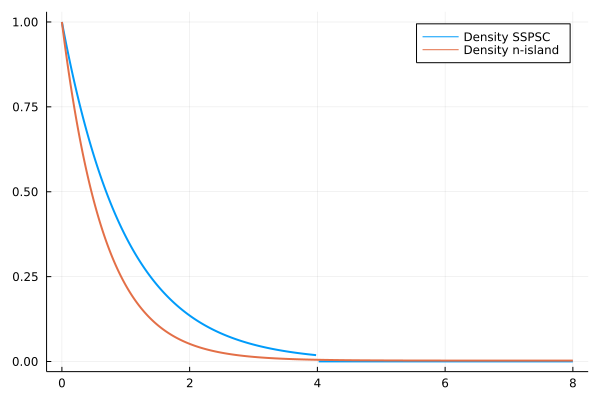

In [32]:
# Second example - Figure 3 right panel Mazet el at. (2015)
m_example2 = 0.5
n_example2 = 43
T_example2 = 4 # this is different from Mazet et al. (2015)
α_example2 = 125.91
#
xs = range(0, 8, step = 0.01);
density_nisland_example2 = density_anal_nI.(xs,(m_example2,), (n_example2,), (1,));
# this works because (Q,) is now considered to be scalar and is broadcasted
density_nisland_example_ys_2 = [x[1] for x in density_nisland_example2];
density_panmictic_example_ys_2 = density_SSPSC.(xs,(α_example2,),(T_example2,));
#
# Making the discontinuous value = NaN
for x = 2:length(xs)
    if abs(xs[x] - T_example2) < 0.01
        density_panmictic_example_ys_2[x] = NaN
    end
end
# 
# 
fig_density_SSPSC_nisland2 = plot(xs, density_panmictic_example_ys_2, label="Density SSPSC", w = 2)
fig_density_SSPSC_nisland2 = plot!(xs, density_nisland_example_ys_2, label="Density n-island", w = 2)
display(fig_density_SSPSC_nisland2)
# savefig(fig_density_SSPSC_nisland2,"fig_density_SSPSC_nisland2.pdf")

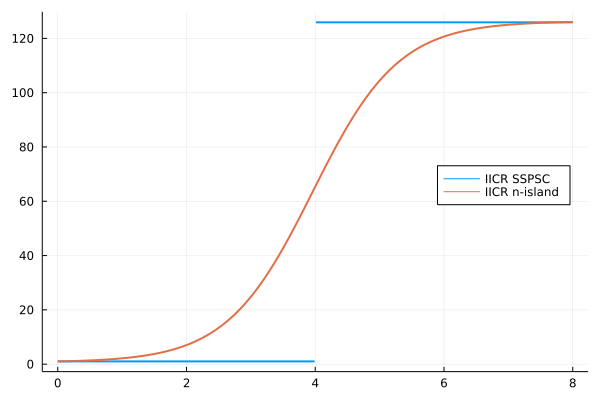

In [33]:
# Second example - Figure 3 right panel Mazet el at. (2015)
m_example2 = 0.5
n_example2 = 43
T_example2 = 4
α_example2 = 125.91
#
xs = range(0, 8, step = 0.01);
IICR_nisland_example2 = IICR_anal_nI.(xs,(m_example2,), (n_example2,), (1,));
# this works because (Q,) is now considered to be scalar and is broadcasted
IICR_nisland_example_ys_2 = [x[1] for x in IICR_nisland_example2];
IICR_panmictic_example_ys_2 = IICR_SSPSC.(xs,(α_example2,),(T_example2,));
# Making the discontinuous value = NaN
for x = 2:length(xs)
    if abs(xs[x] - T_example2) < 0.005
        IICR_panmictic_example_ys_2[x] = NaN
    end
end
#
fig_IICR_SSPSC_nisland2 = plot(xs, IICR_panmictic_example_ys_2, label="IICR SSPSC",
    w = 2, legend = :right)
fig_IICR_SSPSC_nisland2 = plot!(xs, IICR_nisland_example_ys_2, label="IICR n-island", w = 2)
display(fig_IICR_SSPSC_nisland2)
# savefig(fig_IICR_SSPSC_nisland2,"fig_IICR_SSPSC_nisland2.pdf")

### Strong migration

15906.852649386974

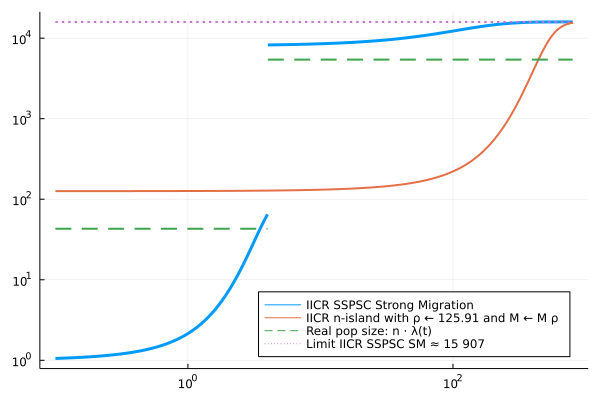

In [45]:
# First example - Figure 3 right panel Mazet el at. (2015)
m_example2 = 0.5
n_example2 = 43
T_example2 = 4
α_example2 = 125.91
# 
# auxiliar parameters
β_example2 = limit_IICR(m_example2, n_example2, 1)
display(α_example2/β_example2) # limit of the IICR_SM
#
xs = range(0.1, 800, step = 0.01);
IICR_nisland_example2 = IICR_anal_nI.(xs,(m_example2,), (n_example2,), (1,)); # IICR of the n-island
IICR_nisland_example_ys_1 = [x[1] for x in IICR_nisland_example2]; 
# extract first component, i.e. when initially both individuals are in the same island
#
IICR_nisland_example2 = IICR_anal_nI.(xs,(m_example2/α_example2,), (n_example2,), (α_example2,)); 
# IICR of the n-island with α_example2 and migration also divided by α_example2
IICR_nisland_example_ys_2 = [x[1] for x in IICR_nisland_example2]; # extract first component
#
IICR_panmictic_example_ys_1 = IICR_SSPSC.(xs,(α_example2,),(T_example2,)); # IICR of the SSPSC model
#
# IICR of the n-island with SSPSC and strong migration
IICR_nisland_with_SSPSC_1 = IICR_nisland_with_SSPSC.(xs,(α_example2,),(T_example2,),(m_example2,),(n_example2,));
IICR_nisland_with_SSPSC_ys_1 = [x[1] for x in IICR_nisland_with_SSPSC_1]
# Making the discontinuous values = NaN
for x = 2:length(xs)
    if abs(xs[x] - T_example2) < 0.005
        IICR_nisland_with_SSPSC_ys_1[x] = NaN
        IICR_panmictic_example_ys_1[x] = NaN
    end
end
#
# Plots
# we use x log axis to increase readability
fig_IICR_SSPSC_nisland_SM = plot(xs, IICR_nisland_with_SSPSC_ys_1, label="IICR SSPSC Strong Migration", w = 3, legend = :bottomright, xaxis = :log, yaxis=:log)
# 
fig_IICR_SSPSC_nisland_SM = plot!(xs, IICR_nisland_example_ys_2, label="IICR n-island with ρ ← 125.91 and M ← M ρ", w = 2)
# 
fig_IICR_SSPSC_nisland_SM = plot!(xs, n_example2*IICR_panmictic_example_ys_1, label="Real pop size: n ⋅ λ(t)", w = 2, line = :dash)
# 
fig_IICR_SSPSC_nisland_SM = plot!([first(xs), last(xs)], [α_example2/ β_example2 , α_example2/ β_example2], 
    label="Limit IICR SSPSC SM ≈ 15 907", w = 2, line =  :dot)
# 
display(fig_IICR_SSPSC_nisland_SM)
# savefig(fig_IICR_SSPSC_nisland_SM,"fig_IICR_SSPSC_nisland_SM2.pdf")

### Weak migration

In [40]:
# First example - Figure 3 right panel Mazet el at. (2015)
m_example2 = 0.5
n_example2 = 43
T_example2 = 4
α_example2 = 125.91
# 
# auxiliar parameters
β_example2 = limit_IICR(m_example2, n_example2, α_example2)
display(1/β_example2)

5496.205683369396

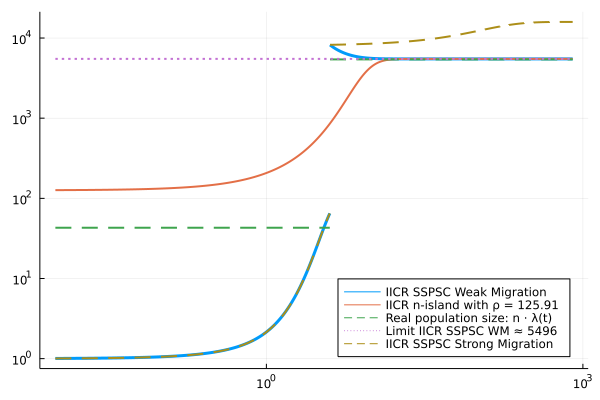

In [44]:
# plotting for the weak migration case
xs = range(0.01, 800, step = 0.01);
# 
# IICR of the n-island model with λ = α
IICR_nisland_example2 = IICR_anal_nI.(xs,(m_example2,), (n_example2,), (α_example2,));
IICR_nisland_example_ys_2 = [x[1] for x in IICR_nisland_example2];
# IICR of the panmictic model
IICR_panmictic_example_ys_1 = IICR_SSPSC.(xs,(α_example2,),(T_example2,)); 
# IICR of the n-island model with SSPSC and weak migration
IICR_nisland_with_SSPSC__WM1 = IICR_nisland_with_SSPSC_WM.(xs,(α_example2,),(T_example2,)
    ,(m_example2,),(n_example2,)); # gives a vector of tuples
IICR_nisland_with_SSPSC_ys_1 = [x[1] for x in IICR_nisland_with_SSPSC_1]
# 
# IICR of the n-island with SSPSC and strong migration
IICR_nisland_with_SSPSC_1 = IICR_nisland_with_SSPSC.(xs,(α_example2,),(T_example2,),(m_example2,),(n_example2,));
IICR_nisland_with_SSPSC_ys_1 = [x[1] for x in IICR_nisland_with_SSPSC_1]
# 
# Making the discontinuous value = NaN
for x = 2:length(xs)
    if abs(xs[x] - T_example2) < 0.005
        IICR_nisland_with_SSPSC__WM1[x] = NaN
        IICR_panmictic_example_ys_1[x] = NaN
        IICR_nisland_with_SSPSC_ys_1[x] = NaN
    end
end
#
# Plots
fig_IICR_SSPSC_nisland_WM = plot(xs, IICR_nisland_with_SSPSC__WM1, 
    label="IICR SSPSC Weak Migration", w = 3, legend = :bottomright, axis=:log)
    fig_IICR_SSPSC_nisland_WM = plot!(xs, IICR_nisland_example_ys_2, 
    label="IICR n-island with ρ = 125.91", w = 2)
    fig_IICR_SSPSC_nisland_WM = plot!(xs, n_example2*IICR_panmictic_example_ys_1, 
        label="Real population size: n ⋅ λ(t)", w = 2, line = :dash)
fig_IICR_SSPSC_nisland_WM = plot!([first(xs), last(xs)], 
    [1/β_example2, 1/β_example2], 
    label="Limit IICR SSPSC WM ≈ 5496", w = 2, line =  :dot)
fig_IICR_SSPSC_nisland_WM = plot!(xs, IICR_nisland_with_SSPSC_ys_1, label="IICR SSPSC Strong Migration", 
    w = 2, line =  :dash)
display(fig_IICR_SSPSC_nisland_WM)
# savefig(fig_IICR_SSPSC_nisland_WM,"fig_IICR_SSPSC_nisland_WM2.pdf")